![KU Leuven](img/logo.png)
# Biometrics System Concepts
## Assignment 2: Fingerprint and Iris based Identification

**Name:** Joe Pesci |
**Student Nr:** KD6-3.7 |
**Date:** February 10, 1942
---

Implement and test a keypoint-based fingerprint and iris recognition system and fuse the two systems together.

A high-level description is provided with links to or hints of code snippets and libraries that you can reuse/adapt at your will (with proper referencing!).

This document is structured as below:  
* [I. Setting](#I.-Setting)
* [II. Fingerprint Recognition](#II.-Fingerprint-Recognition)
  1. Reading data
  2. Baseline model
    1. Choosing a similarity metric
    2. Constructing the similarity matrix
    3. Validation
  3. Model extension 1: local similarity¶
    1. Image enhancements
    2. Feature extraction
    3. local Keypoint Matching
    4. Local Similarity metric
    5. Construct local similarity matrix
    6. Validation
  4. Model extension 2: Global similarity
    1. Image alignment
    2. Global Similarity Metric
    3. Construct global similarity matrix
    4. Validation
  5. Model extension 3: Hybrid features
    1. Hybrid Similarity metric
    2. Construct hybrid similarity matrix
    3. Validation
  6. Solve the murder case
* [III. Iris Recognition](#III.-Iris-recognition)
  1. Reading data
  2. Biometric iris recogntion System
    1. Image enhancement
    2. Construct similarity matrix
    3. Validation
  3. Solve the murder case
* [IV. Multimodal System](#IV-Multimodal-System)
  1. Score fusion
    1. Construct similarity matrix
    2. Validation
  2. Solve the murder case  
* [V. Assignment Instructions](#V.-Assignment-Instructions)


Code examples will be provided below. You can and are invited to adapt these at your will (different parameter settings, different choices of alogorithmic components, add external python files, ...). Try to keep things structured!


In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
#to plot figures inline
%matplotlib inline

import os # OS interfaces
import cv2 # OpenCV package
import math
import pickle # Pickle allows to save and read intermediate results (similar to save and load in Matlab)
import numpy as np # Standard array processing package
import pandas as pd  # Data analysis and manipulation tool
import glob # Path name pattern searching
import zlib # Compression interface

import matplotlib as mpl # Setting the default colormap for pyplot
mpl.rc('image', cmap='gray')

from matplotlib import pyplot as plt # Plotting library
from pathlib import Path # File path processing package
from sklearn.metrics import roc_curve # Package for some simple biometric metrics.
from sklearn.metrics.pairwise import pairwise_distances, cosine_similarity, manhattan_distances, cosine_distances
from tqdm.notebook import tqdm as tqdm_notebook, trange  # A visual progress bar library
from IPython.display import Markdown # Allows us to generate markdown using python code
from itertools import product # Cartesian product of 2 iterables
from base64 import urlsafe_b64encode as b64e, urlsafe_b64decode as b64d # Binary encoding
from scipy.spatial.distance import cityblock
import cv2

import src.fprmodules.enhancement as fe # Local modules for fingerprint enhancement
import src.image_processing as image_processor
import src.plotting_functions as plotter
import src.matrix_construction as matrix_constructor

# <a id='I.-Setting'></a>I. Setting

Oh no! A woman is found dead in her hotel room. Multiple stab wounds in the chest indicate that it was... *MURDER!*

The police has locked down the hotel and you were brought in to assist the forensics team in finding the murderer. Your associates have reviewed the security footage and have detected a person entering the room with the victim just 15 minutes before the estimated time of death. Unfortunately, the perpetrator did their homework and they were very careful not to give away any leads that might help you identify them. They slipped however, and on their way out touched the door knob with their bare hand...

# <a id='II.-Fingerprint-Recognition'></a> II. Fingerprint Recognition

## 1. Reading data
#### *Reading the image data and converting to grayscale*


Before you get started on anything it is always a good idea to visualise your data. Let's first have a look at the fingerprint that was collected from the door knob first... 

Note that we convert the data to grayscale, we're not interested in color values (and don't have them).

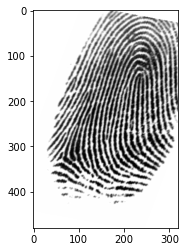

In [3]:
perpetrator_fp = cv2.imread('data/perpetrator_fp.png')

assert (
    (perpetrator_fp[...,0] == perpetrator_fp[...,1]).all() and
    (perpetrator_fp[...,1] == perpetrator_fp[...,2]).all()
)

perpetrator_fp = cv2.cvtColor(perpetrator_fp, cv2.COLOR_BGR2GRAY)

plt.imshow(perpetrator_fp);


Now, let's have a look at the other fingerprint data that was provided to you. This data is stores in `data/NIST301/`. There were apparently 100 guests in the hotel at the time of murder. The filename indicates the subject identifier. Below we have provided a function to read and label these fingerprints. Let's take a look!

In [4]:
# Read the fingerprint database
images_db, labels_db = image_processor.read_db('data\\NIST301\\')

# Save some metadata
n_imgs = len(images_db)
img_height, img_width = images_db[0].shape

Markdown(f"""Here are some samples from the database, which contains {n_imgs} images of size {img_height}x{img_width}. Remember, visualization is always a good idea, so let's visualize some""")

  0%|          | 0/100 [00:00<?, ?it/s]

Here are some samples from the database, which contains 100 images of size 480x320. Remember, visualization is always a good idea, so let's visualize some

  0%|          | 0/20 [00:00<?, ?it/s]

Plotting images...


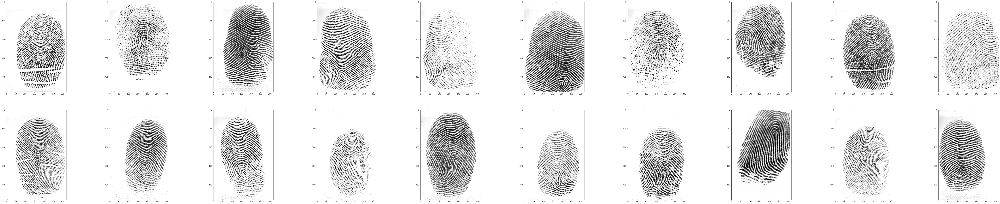

In [5]:
plotter.plot_image_sequence(images_db, n=20)

## 2. A baseline model

### 2.1. Choosing a similarity metric
In your first assignment the similarity metric was already provided, in this assignment you have the chance to play around with distances and similarities yourself! Let's give it a shot!

Consider the similarity function below:

In [6]:
mss = lambda x,y: 1/(1+np.square(x-y).mean())

For better useability, we define the following inline distance function to use a variety of pairwise distance functions from scikit learn.

From scikit-learn: [‘cityblock’, ‘cosine’, ‘euclidean’, ‘l1’, ‘l2’, ‘manhattan’]. These metrics support sparse matrix inputs. [‘nan_euclidean’] but it does not yet support sparse matrices.

From scipy.spatial.distance: [‘braycurtis’, ‘canberra’, ‘chebyshev’, ‘correlation’, ‘dice’, ‘hamming’, ‘jaccard’, ‘kulsinski’, ‘mahalanobis’, ‘minkowski’, ‘rogerstanimoto’, ‘russellrao’, ‘seuclidean’, ‘sokalmichener’, ‘sokalsneath’, ‘sqeuclidean’, ‘yule’]

In [7]:
# distance_sklearn = lambda x, y, dist_fct_n: 1/pairwise_distances(x, y, metric=dist_fct_n).mean()
distance_sklearn = matrix_constructor.distance_sklearn

### 2.2. Constructing the similarity score table
Since we're not in an authentication scenario, all we can do is to calculate the similarity scores between each fingerprint in the database and the one from the perpetrator.
Once we have a metric for each image, we can just sort them and store them in a table. Note that you have space to get creative with visualization!

In [8]:
sim_tb0 = matrix_constructor.construct_similarity_table(perpetrator_fp, images_db, labels_db, mss)
sim_tb0.sort_values(by='score', ascending=False).values[:]

array([['088', 0.017036062327143858],
       ['081', 0.016824130008464642],
       ['042', 0.01666819132869901],
       ['023', 0.016645944127931883],
       ['077', 0.01660774126177098],
       ['052', 0.01653379530364864],
       ['027', 0.016490526160512727],
       ['014', 0.016410414202700667],
       ['051', 0.01641030725415709],
       ['048', 0.01640322370334172],
       ['084', 0.016360468846727545],
       ['090', 0.016244903769568577],
       ['073', 0.016242608740617278],
       ['095', 0.0162036597484635],
       ['041', 0.01615747988756666],
       ['031', 0.016018521415386542],
       ['044', 0.01594281180548607],
       ['012', 0.015923849167559016],
       ['036', 0.01589716850315532],
       ['018', 0.015891402130689403],
       ['049', 0.015855246553729],
       ['022', 0.015822370813329607],
       ['080', 0.01579879900327681],
       ['016', 0.015776186852499742],
       ['100', 0.015751254870480794],
       ['089', 0.01573313650524018],
       ['072', 0.0157283533

#### 2.2.1 Visualizing similarity scores

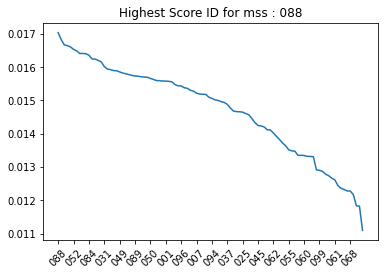

In [9]:
plotter.plot_similarity_scores(sim_tb0, 'mss')

In [10]:
dist_fct = 'euclidean'
sim_tb1 = matrix_constructor.construct_similarity_table(perpetrator_fp, images_db, labels_db, distance_sklearn, dist_fct_n=dist_fct)
sim_tb1.sort_values(by='score', ascending=False).values[:]

array([['038', 0.0005379108568121957],
       ['025', 0.0005371741776657372],
       ['087', 0.0005355981537102191],
       ['057', 0.0005348119139201241],
       ['023', 0.0005343491213607239],
       ['016', 0.0005343396938880533],
       ['047', 0.0005334440804009201],
       ['073', 0.0005329454504644955],
       ['072', 0.0005325713185940351],
       ['100', 0.000532388280562159],
       ['081', 0.0005317818739750455],
       ['085', 0.0005313746465125699],
       ['042', 0.0005309896199409942],
       ['010', 0.0005307083595662779],
       ['059', 0.0005301085119025512],
       ['036', 0.0005277347068863216],
       ['045', 0.000525691529528657],
       ['019', 0.0005252845743431694],
       ['031', 0.000524923028090278],
       ['041', 0.000524530417430554],
       ['002', 0.0005235526663647548],
       ['014', 0.0005224298511550276],
       ['060', 0.0005223455655586643],
       ['044', 0.0005223015663161357],
       ['012', 0.0005212812538680393],
       ['033', 0.000521206386

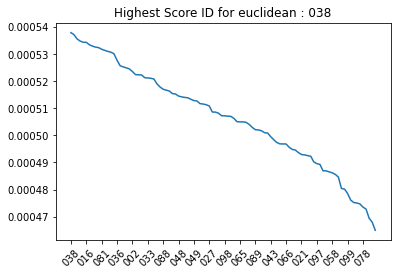

In [11]:
plotter.plot_similarity_scores(sim_tb1, dist_fct)

  0%|          | 0/4 [00:00<?, ?it/s]

Plotting images...


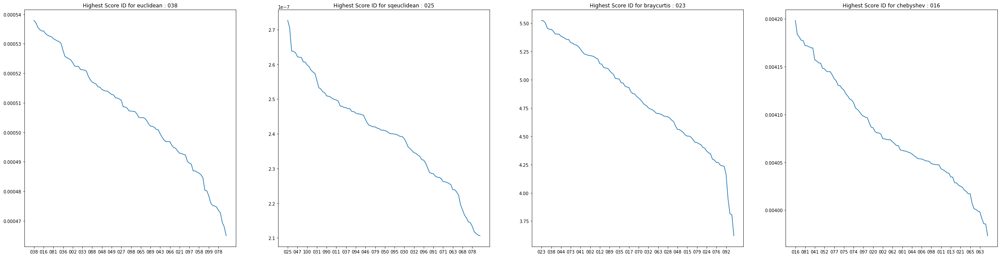

In [12]:
# plotter.plot_multiple_distance_fct_scores(perpetrator_fp, images_db, labels_db, distance_sklearn, ['cityblock', 'cosine', 'euclidean', 'l1', 'l2', 'manhattan', 'jaccard', 'hamming', 'sqeuclidean', 'braycurtis', 'canberra', 'chebyshev'], imgs_per_row=3)
plotter.plot_multiple_distance_fct_scores(perpetrator_fp, images_db, labels_db, distance_sklearn, ['euclidean', 'sqeuclidean', 'braycurtis','chebyshev'], imgs_per_row=4)

<div class="alert alert-block alert-success">
<b>Q1: </b> Now that we have some results, is the given similarity function a good metric to quantify the distance between two fingerprints? Is it reliable enough to incriminate a suspect? What are its limitations?
</div>

## 3. Model extension 1 : *Local Similarity*

### 3.1. Image enhancements
In this next step we re-use code developed by [Utkarsh Deshmukh](https://github.com/Utkarsh-Deshmukh/Fingerprint-Enhancement-Python), to enhance the fingerprint images. It is a Python-recode of Matlab-code developed by [Peter Kovesi](https://www.peterkovesi.com/matlabfns/index.html#fingerprints). I have slightly adapted this code to make it more compliant with OpenCV. It uses gradient-based orientation and local frequency estimation as input to an orientation and frequency selective filtering using a Gabor filterbank. At the same time a foreground region segmentation (mask) is determined by calculating the standard deviation in local windows and thresholding above a certain level. Please briefly read through the [github README](https://github.com/Utkarsh-Deshmukh/Fingerprint-Enhancement-Python) to better understand what it is doing!

<div class="alert alert-block alert-info">
<b>Tip:</b> Intermediate (computation heavy) results can be saved on file using the pickle package, use <code>pickle.dump</code> to save and <code>pickle.load</code> to load data from a file. The code snippet below will run the computation and save results if there are no previous records, and reload them in later runs. 
Have a look at the <a href="https://wiki.python.org/moin/UsingPickle">wiki</a> for more information. 
<pre>
<code>
<!-- language: lang-python -->
try:
    with open("images_masks_db.pkl","rb") as f:
        images_enhanced_db, masks_db = pickle.load(f)
except:
    images_enhanced_db, masks_db = enhance_images(images_db)
    with open("images_masks_db.pkl",'wb') as f:
        pickle.dump([images_enhanced_db,masks_db],f)
</code>
</pre>

</div>


In [13]:
try:
    with open("data/images_masks_db.pkl","rb") as f:
        images_enhanced_db, masks_db = pickle.load(f)
except:
    images_enhanced_db, masks_db = image_processor.enhance_images(images_db)
    with open("data/images_masks_db.pkl",'wb') as f:
        pickle.dump([images_enhanced_db,masks_db],f)

Note that the images are now much more crisp and that the foreground segmentation was successful even if the technique is rather simple!

  0%|          | 0/4 [00:00<?, ?it/s]

Plotting images...


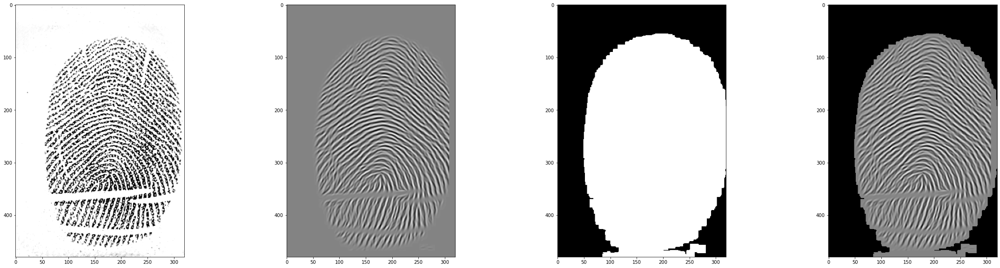

In [14]:
n=1
images_segmented_db = [a*b for a,b in zip(images_enhanced_db,masks_db)]
plotter.plot_image_sequence(images_db[:n] + images_enhanced_db.tolist()[:n] + masks_db.tolist()[:n] + images_segmented_db[:n], n=4*n, imgs_per_row=4)

### 3.2. Feature extraction
As you might have noticed by now comparing images on a pixel level is too simple and limited. The basic/traditional fingerprint matching algorithm are based on matching keypoints, called minutiae. They are defined as the ridge endings and bifurcations and can be determined by first thresholding the FP image and skeletonizing/thinning the enhanced image. For those really interested (but not part of this assignment) in experimenting with such an approach, some code is provided in the `fprmodules/minutiae_extraction` folder.

Instead, we will rely on establised methods developed in Computer Vision, where the use of keypoint features has proven to be very succesfull (prior to the advent of Deep Learning) in image classification, image alignment and object recognition tasks. A keypoint is a point of interest in an image, it does not necesarily need to be recognisable by a human but it can be. In this project we use keypoints to compare images on 3 levels:
1. Local feature descriptors
2. Global features
3. Hybrid features

To better highlight what is going on we will plot the results on two fingerprint images from our database.

In [15]:
# test example
testNr1 = 48

testNr2 = 17

#### 3.2.1 Keypoint detection

**Keypoint detection** algorithms will result in points of interest on your image, which keypoints are used is dependent on the technique. We will make use of ORB (Oriented FAST and Rotated BRIEF) detection and descriptor algorithm as implemented in [OpenCV ORB](https://opencv24-python-tutorials.readthedocs.io/en/latest/py_tutorials/py_feature2d/py_orb/py_orb.html).


You are encouraged to try out a series of detection/description/matching algorithms. A short overview of these methods can be found in the OpenCV documentation: [Feature detection and description](https://opencv24-python-tutorials.readthedocs.io/en/latest/py_tutorials/py_feature2d/py_table_of_contents_feature2d/py_table_of_contents_feature2d.html). 
Please read these pages carefully and try to understand these methods.

We define different types of detectors (for some of them, the local descriptions will need to be computed with a different kind of detector (brief)

In [16]:
detector_orb= cv2.ORB_create()
detector_sift = cv2.SIFT_create()
# Harris
detector_harris = cv2.xfeatures2d.HarrisLaplaceFeatureDetector_create()
# Fast
detector_fast = cv2.FastFeatureDetector_create()
# Brief
detector_star = cv2.xfeatures2d.StarDetector_create()

##### 1. [FING and IRIS] OpenCV provides different KeyPoint detectors and descriptors (ORB, SIFT, SURF, BRIEF, …). Briefly test, visually, which of these seem to extract relatively reliable interesting points from the fingerprints or iris dataset (you can skip the ones that require a lisence). Use at least 3 detectors. (1pt)

In [17]:
kp1_orb = image_processor.detect_keypoints(images_enhanced_db[testNr1], masks_db[testNr1], detector_orb)
kp2_orb = image_processor.detect_keypoints(images_enhanced_db[testNr2], masks_db[testNr2], detector_orb)

kp1_sift = image_processor.detect_keypoints(images_enhanced_db[testNr1], masks_db[testNr1], detector_sift)
kp2_sift = image_processor.detect_keypoints(images_enhanced_db[testNr2], masks_db[testNr2], detector_sift)

kp1_harris = image_processor.detect_keypoints(images_enhanced_db[testNr1], masks_db[testNr1], detector_harris)
kp2_harris = image_processor.detect_keypoints(images_enhanced_db[testNr2], masks_db[testNr2], detector_harris)

kp1_fast = image_processor.detect_keypoints(images_enhanced_db[testNr1], masks_db[testNr1], detector_fast)
kp2_fast = image_processor.detect_keypoints(images_enhanced_db[testNr2], masks_db[testNr2], detector_fast)

kp1_star = image_processor.detect_keypoints(images_enhanced_db[testNr1], masks_db[testNr1], detector_star)
kp2_star = image_processor.detect_keypoints(images_enhanced_db[testNr2], masks_db[testNr2], detector_star)

In [18]:
ids = [testNr1]
kps_list = [[kp1_orb, kp2_orb], [kp1_sift, kp2_sift], [kp2_harris, kp2_harris], [kp1_fast, kp2_fast], [kp1_star, kp2_star]]
detector_names = ['ORB', 'SIFT', 'HARRIS', 'FAST', 'STAR (BRIEF)']

  0%|          | 0/5 [00:00<?, ?it/s]

Plotting images...


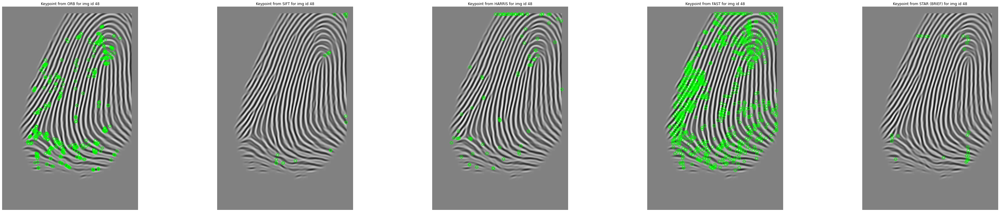

In [19]:
plotter.draw_keypoints(images_enhanced_db, ids, kps_list, detector_names, cv2.DRAW_MATCHES_FLAGS_DEFAULT, imgs_per_row=5)

  0%|          | 0/5 [00:00<?, ?it/s]

Plotting images...


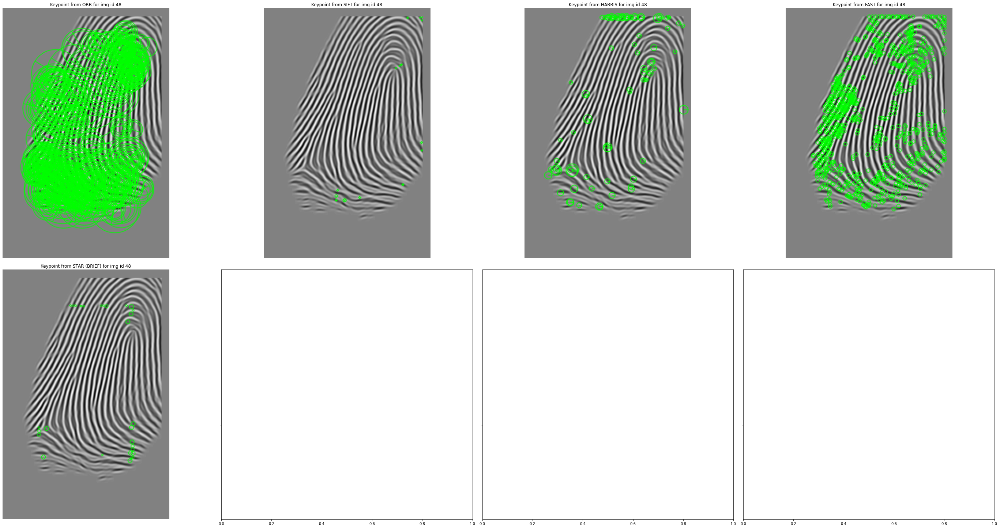

In [20]:
plotter.draw_keypoints(images_enhanced_db, ids, kps_list, detector_names, cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

#### 3.2.2 The Local Feature descriptor
**The Local Feature descriptor** will give you a vector describing the local region around the key-point in the feature space. Note that these feature descriptors give a vectorial summary of the neighbourhood around each keypoint. A simple metric on these vectors (Euclidean Distance for continuous variables, Hamming Distance for binary variables) can then be used to determine similarity.

In [21]:
kp1_orb, local_des1_orb = image_processor.compute_local_descriptor(images_enhanced_db[testNr1], kp1_orb, detector_orb)
kp2_orb, local_des2_orb = image_processor.compute_local_descriptor(images_enhanced_db[testNr2], kp2_orb, detector_orb)

kp1_sift, local_des1_sift = image_processor.compute_local_descriptor(images_enhanced_db[testNr1], kp1_sift, detector_sift)
kp2_sift, local_des2_sift = image_processor.compute_local_descriptor(images_enhanced_db[testNr2], kp2_sift, detector_sift)

brief_detector = cv2.xfeatures2d.BriefDescriptorExtractor_create()
kp1_harris, local_des1_harris = image_processor.compute_local_descriptor(images_enhanced_db[testNr1], kp1_harris, brief_detector)
kp2_harris, local_des2_harris = image_processor.compute_local_descriptor(images_enhanced_db[testNr2], kp2_harris, brief_detector)
kp1_fast, local_des1_fast = image_processor.compute_local_descriptor(images_enhanced_db[testNr1], kp1_fast, brief_detector)
kp2_fast, local_des2_fast = image_processor.compute_local_descriptor(images_enhanced_db[testNr2], kp2_fast, brief_detector)
kp1_star, local_des1_star = image_processor.compute_local_descriptor(images_enhanced_db[testNr1], kp1_star, brief_detector)
kp2_star, local_des2_star = image_processor.compute_local_descriptor(images_enhanced_db[testNr2], kp2_star, brief_detector)

##### Visualization of local descriptors

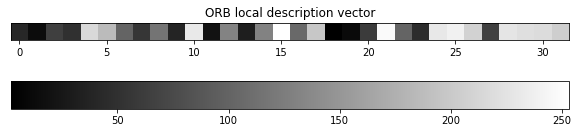

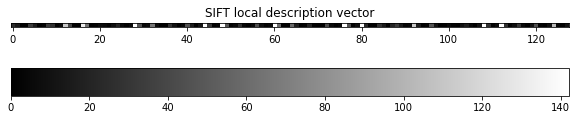

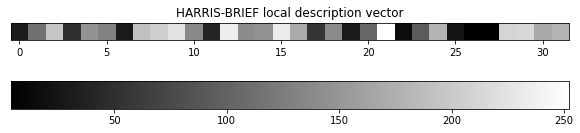

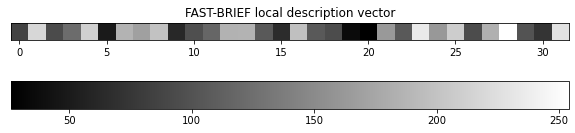

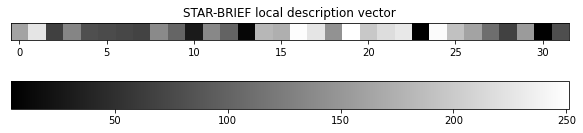

In [22]:
plotter.plot_vector_descriptor(local_des1_orb, detector_name='ORB')
plotter.plot_vector_descriptor(local_des1_sift, detector_name='SIFT')
plotter.plot_vector_descriptor(local_des1_harris, detector_name='HARRIS-BRIEF')
plotter.plot_vector_descriptor(local_des1_fast, detector_name='FAST-BRIEF')
plotter.plot_vector_descriptor(local_des1_star, detector_name='STAR-BRIEF')

In [23]:
from sklearn.decomposition import PCA

kps_orb = [image_processor.detect_keypoints(images_enhanced_db[i], masks_db[i], detector_orb) for i in range(images_enhanced_db.shape[0])]
des_orb = [(image_processor.compute_local_descriptor(images_enhanced_db[i], kp, detector_orb))[1] for i, kp in enumerate(kps_orb)]

kps_sift = [image_processor.detect_keypoints(images_enhanced_db[i], masks_db[i], detector_sift) for i in range(images_enhanced_db.shape[0])]
des_sift = [(image_processor.compute_local_descriptor(images_enhanced_db[i], kp, detector_sift))[1] for i, kp in enumerate(kps_sift)]

pca = PCA(n_components=10)
# np.ndarray doesn't support arrays as big as 100
local_des_orb_array = np.asarray([pca.fit_transform(local_des.T).flatten() for local_des in des_orb])
local_des_sift_array = np.asarray([pca.fit_transform(local_des.T).flatten() for local_des in des_sift])

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 100 samples in 0.000s...
[t-SNE] Computed neighbors for 100 samples in 0.002s...
[t-SNE] Computed conditional probabilities for sample 100 / 100
[t-SNE] Mean sigma: 2278.321301
[t-SNE] KL divergence after 250 iterations with early exaggeration: 57.357525
[t-SNE] KL divergence after 1000 iterations: 0.565725
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 100 samples in 0.000s...
[t-SNE] Computed neighbors for 100 samples in 0.003s...
[t-SNE] Computed conditional probabilities for sample 100 / 100
[t-SNE] Mean sigma: 1400.656594
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.768265
[t-SNE] KL divergence after 950 iterations: 0.204747


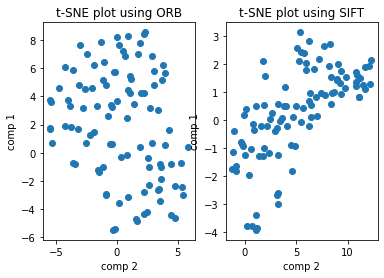

In [24]:
fig, axes = plt.subplots(1, 2)
plotter.plot_TSNE(local_des_orb_array, axes[0], title='ORB')
plotter.plot_TSNE(local_des_sift_array, axes[1], title='SIFT')

### 3.3. Local Keypoint Matching
**Keypoint Matchers** match keypoints that have similar descriptors in an image pair and computes the distances between the best matching pairs of keypoints. In this implementation we make use of the brute force matcher of OpenCV, documentation can be found [here](https://opencv24-python-tutorials.readthedocs.io/en/latest/py_tutorials/py_feature2d/py_matcher/py_matcher.html). As a distance between descriptors we make use of the normalised [Hamming distance](https://en.wikipedia.org/wiki/Hamming_distance).

In [25]:
local_k1_k2_matches_orb = image_processor.brute_force_matcher(local_des1_orb, local_des2_orb, cv2.NORM_HAMMING)
local_k1_k2_matches_sift = image_processor.brute_force_matcher(local_des1_sift, local_des2_sift, cv2.NORM_L2)
local_k1_k2_matches_harris = image_processor.brute_force_matcher(local_des1_harris, local_des2_harris, cv2.NORM_L2)
local_k1_k2_matches_fast = image_processor.brute_force_matcher(local_des1_fast, local_des2_fast, cv2.NORM_L2)
local_k1_k2_matches_star = image_processor.brute_force_matcher(local_des1_star, local_des2_star, cv2.NORM_L2)

# save the source index and target index of the keypoints in the corresponding keypoint sets
local_pt_source, local_pt_target = np.array([
    (match.queryIdx, match.trainIdx) for match in local_k1_k2_matches_orb]).T

#### 3.3.1 Visualizing brute force matches

Text(0.5, 1.0, 'FAST keypoint matching')

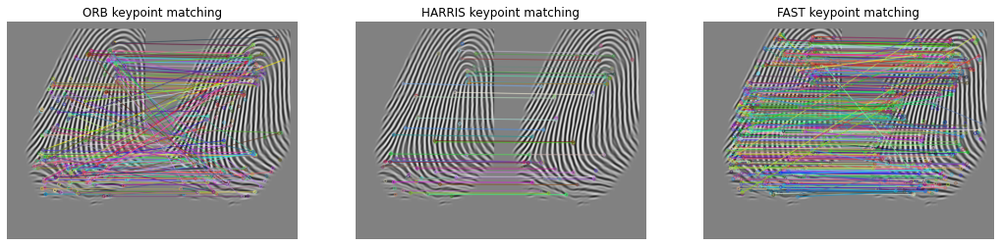

In [26]:
fig, axs = plt.subplots(1, 3, figsize=(18, 10))
plotter.draw_matches(kp1_orb, kp2_orb, local_k1_k2_matches_orb, images_enhanced_db, testNr1, testNr2, axs[0])
axs[0].set_title('ORB keypoint matching')
# plotter.draw_matches(kp1_sift, kp2_sift, local_k1_k2_matches1,images_enhanced_db, testNr1, testNr2)
plotter.draw_matches(kp1_harris, kp2_harris, local_k1_k2_matches_harris,images_enhanced_db, testNr1, testNr2, axs[1])
axs[1].set_title('HARRIS keypoint matching')
plotter.draw_matches(kp1_fast, kp2_fast, local_k1_k2_matches_fast,images_enhanced_db, testNr1, testNr2, axs[2])
axs[2].set_title('FAST keypoint matching')
# plotter.draw_matches(kp1_star, kp2_star, local_k1_k2_matches4,images_enhanced_db, testNr1, testNr2)

<div class="alert alert-block alert-success">
<b>Q2:</b> Are all the keypoint matches accurate? Are they expected to be? Explain why.
</div>

<div class="alert alert-block alert-info">
<b>Tip:</b> Make sure you spent the proper amount of time on constructing the similarity metrics, a good implementation will save you a lot of time in the long run! </div>

### 3.4. Local Similarity metric
Now that we have matching keypoints we can define simple scalar measures on this set of distances, such as the number of pairs with a distance smaller than a set threshold, or the sum/mean of the first N distances (ranked from small to larger), etc.

See *local_similarity* and *local_img_similarity* fcts in src.matrix_construction

<div class="alert alert-block alert-info">
<b>Tip:</b> Don't forget to apply the same preprocessing to the perpetrator image.

</div>


In [27]:
perp_img_en, perp_img_mask = image_processor.enhance_images([perpetrator_fp])
perp_img_en = perp_img_en[0]
perp_img_mask = perp_img_mask[0]

  0%|          | 0/1 [00:00<?, ?it/s]

#### 3.5 Local Similarity Scores

In [28]:
sim_tb1 = matrix_constructor.construct_similarity_table(np.stack((perp_img_en, perp_img_mask), -1), np.stack((images_segmented_db, masks_db), -1), labels_db, matrix_constructor.local_similarity, detector=detector_orb, metric='harmonic_mean', top_n=20)
sim_tb1.sort_values(by='score', ascending=False)

[26.0, 52.0, 52.0, 54.0, 54.0, 55.0, 56.0, 57.0, 61.0, 62.0, 64.0, 64.0, 66.0, 66.0, 66.0, 66.0, 68.0, 68.0, 70.0, 70.0, 70.0, 70.0, 71.0, 72.0, 72.0, 72.0, 73.0, 73.0, 74.0, 74.0, 74.0, 74.0, 74.0, 74.0, 74.0, 75.0, 75.0, 75.0, 75.0, 76.0, 76.0, 76.0, 78.0, 78.0, 78.0, 79.0, 79.0, 79.0, 79.0, 80.0, 80.0, 80.0, 81.0, 81.0, 81.0, 81.0, 82.0, 82.0, 82.0, 82.0, 82.0, 83.0, 83.0, 83.0, 83.0, 83.0, 83.0, 84.0, 84.0, 84.0, 84.0, 84.0, 84.0, 85.0, 85.0, 85.0, 85.0, 85.0, 85.0, 86.0, 86.0, 86.0, 87.0, 87.0, 87.0, 87.0, 87.0, 87.0, 87.0, 87.0, 87.0, 88.0, 88.0, 88.0, 88.0, 88.0, 88.0, 88.0, 88.0, 89.0, 89.0, 89.0, 90.0, 90.0, 90.0, 90.0, 90.0, 91.0, 91.0, 91.0, 92.0, 92.0, 92.0, 92.0, 93.0, 93.0, 94.0, 95.0, 96.0, 97.0, 99.0]
[52.0, 52.0, 56.0, 59.0, 60.0, 60.0, 60.0, 60.0, 61.0, 61.0, 62.0, 64.0, 65.0, 65.0, 65.0, 66.0, 67.0, 68.0, 68.0, 69.0, 69.0, 69.0, 69.0, 70.0, 71.0, 71.0, 72.0, 72.0, 72.0, 73.0, 74.0, 74.0, 75.0, 75.0, 75.0, 75.0, 75.0, 76.0, 76.0, 76.0, 76.0, 76.0, 77.0, 77.0, 77.0, 77

,id,score
48,049,0.075649
55,056,0.046211
17,018,0.042502
47,048,0.042185
75,076,0.040570
...,...,...
41,042,0.014602
84,085,0.014545
49,050,0.014483
80,081,0.014443


1 049 0.07565
2 056 0.04621
3 018 0.04250
4 048 0.04219
5 076 0.04057
6 022 0.03703
7 068 0.02135
8 045 0.02135
9 053 0.02118
10 097 0.02090
Knee at: 6	 Treshold:  0.1150137744372369


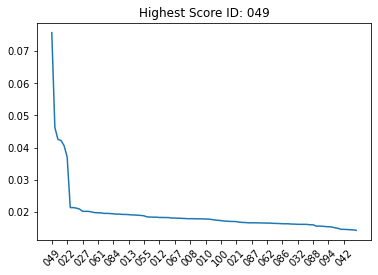

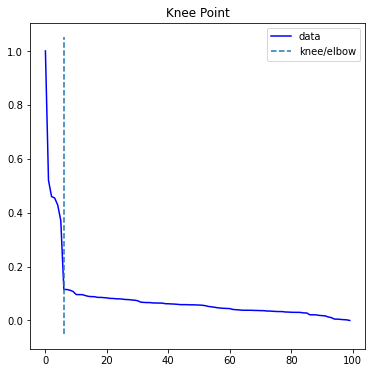

In [29]:
sim_tb1, ids1, scores1, kneedle1 = plotter.plot_highest_score_and_knee(sim_tb1, similarity_metric='global')

A good idea in this plot, where we cannot see one clear subject (as the first 6 subjects are all pretty close), is to take a look at the knee point for a score threshold. Also, let's normalize our scores in order to get a well generalized scale.

  0%|          | 0/6 [00:00<?, ?it/s]

Plotting images...


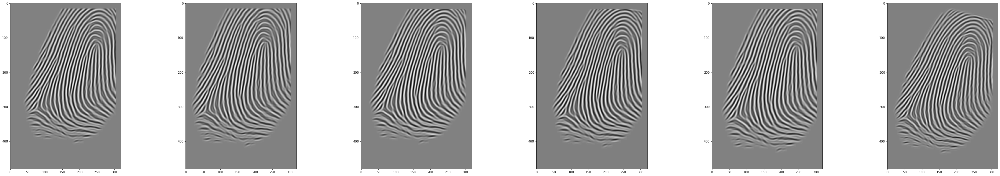

In [30]:
plotter.plot_images_given_knee(ids1, kneedle1, labels_db, images_enhanced_db)

## 4. Model extension 2: Global similarity


**Global features**, here we use the matching keypoints to align the fingerprints, this allows us to compare the images as a whole (globally). Once the images are aligned we can take into account the distance between the key-points in the ambient space (the coordinates of the key-points). This is also referred to as geometrical distance since this is just comparing two points that are part of the intrinsic geometry of the object (no matter how you move the image around the point will move around with it and stay in the same location on the finger).

### 4.1 Image alignment
[Here](https://www.learnopencv.com/image-alignment-feature-based-using-opencv-c-python/) you can find a description and code how to start from the brute force matching results and estimate the best transformation (from a family of transformations) that aligns the two images. In the example, a homography-type transformation is searched for. However, this has too many degrees of freedom for our application. We substituted this by a more constrained (only 4 degrees of freedom) similarity (partial affine) transformation.

These routines iteratively determine the minimal set of matching points that define a transformation that optimally aligns all other points as well, taking care of outliers at the same time. This method is a very general optimization technique and is called RANSAC, for "RANdom SAmple Consensus". See, apart from many other sources on the internet, [this presentation](http://www.cse.psu.edu/~rtc12/CSE486/lecture15.pdf) for further explanation.

In [31]:
# estimate the affine transform that aligns the matched keypoints
M, inliers = image_processor.estimate_affine_transform_by_kps(
    cv2.KeyPoint.convert(np.array(kp1_orb)[local_pt_source]),
    cv2.KeyPoint.convert(np.array(kp2_orb)[local_pt_target]))

kp1_reg = image_processor.warp_points(cv2.KeyPoint.convert(kp1_orb), M)
img1_reg =  image_processor.warp_img(images_enhanced_db[testNr1], M)

Let's have a look at how the images are alinged. Try visualizing different pairs of fingerprints! You may notice the estimated transform will be more extreme for images that are less similar, and will become more subtle as the images become more similar.

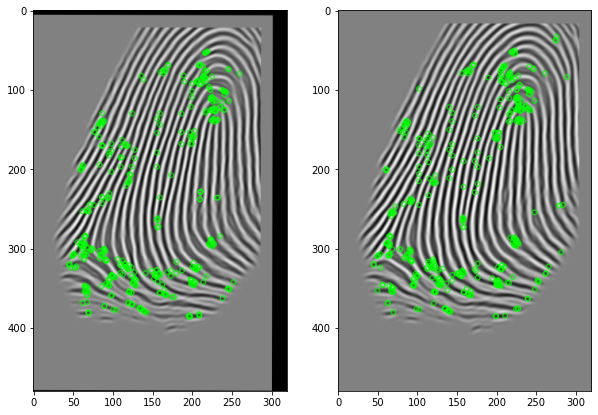

In [32]:
show_img1 = cv2.drawKeypoints(img1_reg, kp1_reg, None, (0, 255, 0), cv2.DRAW_MATCHES_FLAGS_DEFAULT)
show_img2 = cv2.drawKeypoints(images_enhanced_db[testNr2], kp2_orb, None, (0, 255, 0), cv2.DRAW_MATCHES_FLAGS_DEFAULT)

fig, ax = plt.subplots(nrows = 1, ncols = 2, figsize=(10,10))
_=ax[0].imshow(show_img1), ax[1].imshow(show_img2), plt.show()

As you might have noticed the `estimateAffinePartial2D` function does not only return the transformation matrix but also the minimal set of matching points that were used to to determine the transformation. This gives us a better, more refined set of keypoints. 

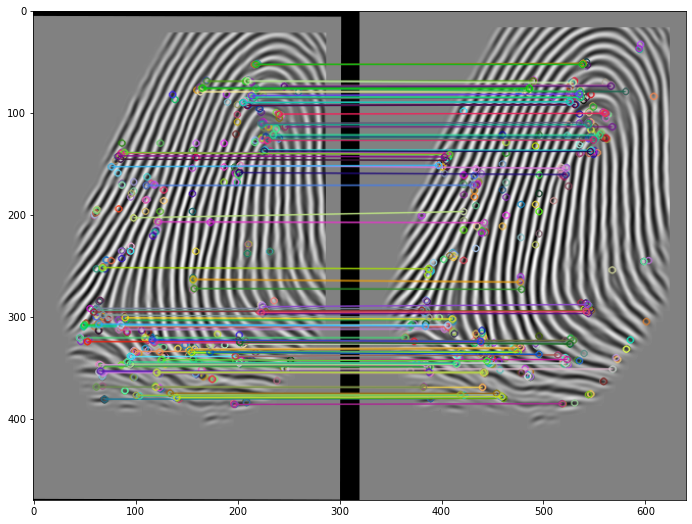

In [33]:
global_k1_k2_matches = local_k1_k2_matches_orb[inliers == 1]

imMatches = cv2.drawMatches(img1_reg, kp1_reg, images_enhanced_db[testNr2], kp2_orb, global_k1_k2_matches.tolist(), None)
_ = plt.imshow(imMatches)
f=plt.gcf()
f.set_size_inches(18,9), plt.show();

### 4.2 Global Similarity Metric

<div class="alert alert-block alert-success">
<b>Q3: </b> Choose a global feature similarity function, (e.g. you can start from euclidean distance between the reduced sets of KeyPoints and count the values above a threshold).
</div>

In [34]:
thresholds_fingerprint = {
    'euclidean': 0.01, 'sqeuclidean': 0.00025, 'cityblock': 0.01, 'l1': 0.01, 'l2': 0.01,
    'manhattan': 0.01, 'braycurtis': 4, 'canberra': 4, 'chebyshev': 0.01
}

'cityblock', 'euclidean', 'l1', 'l2', 'manhattan', 'sqeuclidean', 'braycurtis', 'canberra', 'chebyshev'

In [35]:
# detectors = [detector_orb, detector_sift, detector_fast, detector_harris, detector_star]
# dist = ['sqeuclidean', 'braycurtis', 'canberra']
# for detect in detectors:
#     for di in dist:
#         print("detector", detect)
#         print("dist", di)
sim_tb2 = matrix_constructor.construct_similarity_table(np.stack((perp_img_en, perp_img_mask), -1), np.stack((images_segmented_db, masks_db), -1), labels_db, matrix_constructor.global_similarity, dist_fct_n='canberra', detector=detector_fast, thresholds=thresholds_fingerprint)
sim_tb2.sort_values(by='score', ascending=False)

,id,score
55,056,174
48,049,149
75,076,127
17,018,119
21,022,107
...,...,...
58,059,0
60,061,0
63,064,0
66,067,0


<div class="alert alert-block alert-success">
<b>Q4: </b> Visualize the scores and determine a score threshold to discriminate the matching fingerprints. Explain how you determine the threshold.
</div>

1 056 174.00000
2 049 149.00000
3 076 127.00000
4 018 119.00000
5 022 107.00000
6 048 103.00000
7 053 18.00000
8 068 17.00000
9 005 15.00000
10 078 13.00000
Knee at: 9	 Treshold:  0.07471264367816093


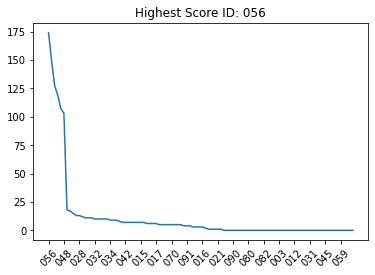

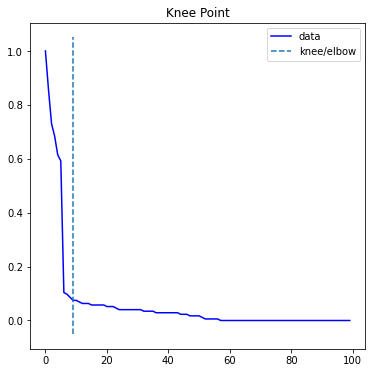

In [36]:
sim_tb2, ids2, scores2, kneedle2 = plotter.plot_highest_score_and_knee(sim_tb2, similarity_metric='hybrid')

  0%|          | 0/7 [00:00<?, ?it/s]

Plotting images...


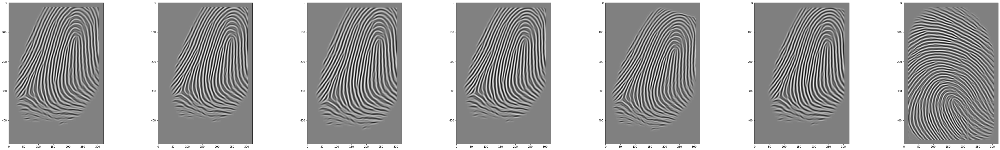

In [37]:
plotter.plot_images_given_knee(ids2, kneedle2, labels_db, images_enhanced_db)

## 5. Model extension 3: Hybrid features


Since we again run into the same problem of a lack of clear disctinction, we can now give hybrid features a shot.

#### 5.1 Hybrid Similarity metric
<div class="alert alert-block alert-success">
<b>Q5: </b> Choose a hybrid feature similarity function that makes use of both the geometric distance and the feature distance of the keypoints. Using this hybrid function, visualize and assess the matches.
</div>

### 5.2 Construct hybrid similarity matrix


'cityblock', 'cosine', 'euclidean', 'l1', 'l2', 'manhattan', 'jaccard', 'hamming', 'sqeuclidean', 'braycurtis', 'canberra', 'chebyshev'

In [38]:
sim_tb3 = matrix_constructor.construct_similarity_table(np.stack((perp_img_en, perp_img_mask), -1), np.stack((images_segmented_db, masks_db), -1), labels_db, matrix_constructor.hybrid_similarity, dist_fct_n='sqeuclidean', detector=detector_fast, thresholds=thresholds_fingerprint)
sim_tb3.sort_values(by='score', ascending=False)

dist 62.0
dist 66.0
dist 67.0
dist 68.0
dist 69.0
dist 70.0
dist 71.0
dist 75.0
dist 76.0
dist 77.0
dist 78.0
dist 78.0
dist 80.0
dist 84.0
dist 85.0
highest score  0.00021986388419972043 1
lowest score  0.00018497669838339332 0
lower than  4
dist 47.0
dist 47.0
dist 55.0
dist 55.0
dist 55.0
dist 60.0
dist 60.0
dist 61.0
dist 61.0
dist 61.0
dist 62.0
dist 69.0
dist 71.0
dist 80.0
dist 80.0
dist 81.0
lower than  0
dist 34.0
dist 53.0
dist 55.0
dist 56.0
dist 57.0
dist 58.0
dist 59.0
dist 59.0
dist 62.0
dist 63.0
dist 64.0
dist 64.0
dist 65.0
dist 68.0
dist 70.0
highest score  0.0001157998242834369 3
lowest score  6.223436663772074e-05 4
lower than  15
dist 67.0
dist 70.0
dist 72.0
dist 75.0
dist 75.0
dist 76.0
dist 79.0
dist 79.0
dist 81.0
dist 83.0
dist 84.0
dist 85.0
dist 86.0
dist 91.0
highest score  4.136846254541203e-05 9
lowest score  1.986066497900484e-05 12
lower than  14
dist 48.0
dist 49.0
dist 49.0
dist 56.0
dist 64.0
dist 69.0
dist 72.0
dist 74.0
dist 75.0
dist 76.0
dist 76.

,id,score
55,056,373
48,049,369
47,048,311
75,076,308
17,018,299
...,...,...
84,085,0
58,059,0
71,072,0
80,081,0


1 056 373.00000
2 049 369.00000
3 048 311.00000
4 076 308.00000
5 018 299.00000
6 022 263.00000
7 053 21.00000
8 068 19.00000
9 034 18.00000
10 033 18.00000
Knee at: 6	 Treshold:  0.05630026809651475


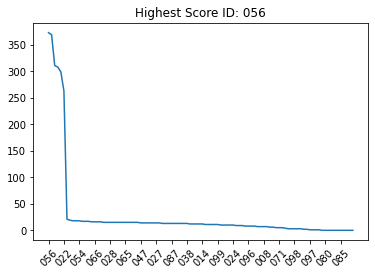

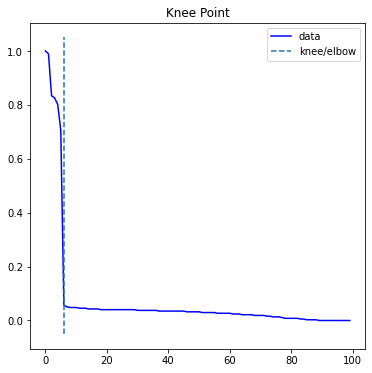

In [39]:
sim_tb3, ids3, scores3, kneedle3 = plotter.plot_highest_score_and_knee(sim_tb3, similarity_metric='hybrid')

  0%|          | 0/6 [00:00<?, ?it/s]

Plotting images...


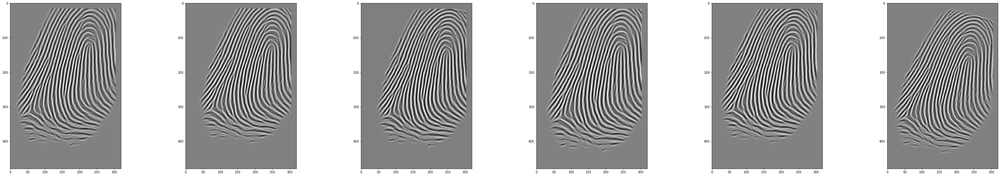

In [40]:
plotter.plot_images_given_knee(ids3, kneedle3, labels_db, images_enhanced_db)

Oh no! Still no clear distinction... This is suspicious, let's take a look at the best matching fingerprints.

The top matching subjects all have the same fingerprint! The murderer must have hacked the database and replicated some of the images, effectively covering their tracks. They seem to be one step ahead all the time... Or so they think! Fingerprints are not the only biometric you can evaluate.

You call your friends at CSI New York and send them the video surveillance records. By making use of the revolutionary (and non-existent) technology of ***zoom-and-enhance***, they return to you a database of iris images.

![Zoom and Enhance](img/csi_zoom_enhance.gif)

## III. Iris recognition
Now let's create a biometric system for the iris data. 

In [41]:
# set path
# CHANGE THIS FOR YOUR SYSTEM
iris_data_path = 'data/CASIA1'

### 1. Reading data

<div class="alert alert-block alert-success">
<b>Q6: </b> Check out <code>iris_perpetrator.png</code>. Where do you see difficulties? What kind of similarity measures do you expect to work best?
</div>

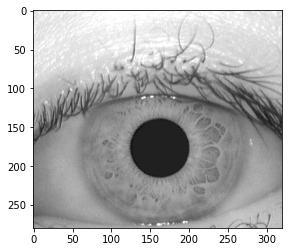

In [42]:
iris_perpetrator = cv2.cvtColor(cv2.imread("data/perpetrator_iris.bmp"),cv2.COLOR_BGR2GRAY)
plt.imshow(iris_perpetrator,cmap='gray');

Let's read the iris data... The images are stored as XXX.png, where XXX stands for the unique identifier of subject, ranging from from 000 to 100.

In [43]:
# read iris Database
iris_images, iris_labels = image_processor.read_iris_db(iris_data_path)
# save data properties
n_images = len(iris_images)
img_height, img_width = iris_images[0].shape[0], iris_images[0].shape[1]

Markdown("""
Let's have a look at the dataset... It contains {} images of size of the images is {}×{}. Let's visualise the first 7:
""".format(n_images,img_height,img_width))


Let's have a look at the dataset... It contains 100 images of size of the images is 280×320. Let's visualise the first 7:


  0%|          | 0/7 [00:00<?, ?it/s]

Plotting images...


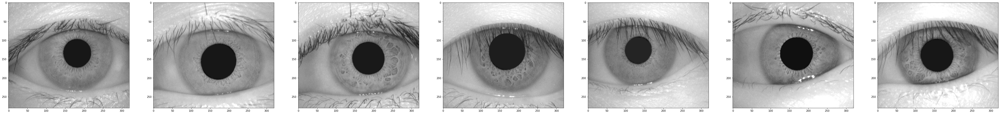

In [44]:
n = 7
plotter.plot_image_sequence(iris_images, n)

### 2. Biometric iris recogntion System
#### 2.1. Image enhancement
Similar to the image enhancement in the [fingerprints](#3.1.-Image-enhancements) section, we will use [open source code](https://github.com/thuyngch/Iris-Recognition) to segment (based on Daugman's intefro-differential) and normalise (by unwraping the circular region) the iris images. We strongly encourage you to go through the source code or github repository to learn more. 

Also similar to the fingerprint section we enhance the images using a gabor filter bank, this time we implement this using [OpenCV](https://docs.opencv.org/3.4/d4/d86/group__imgproc__filter.html#gae84c92d248183bd92fa713ce51cc3599). 

In [45]:
try:
    with open("data/iris_mask_db.pkl", "rb") as f:
        enhanced_iris, mask_iris = pickle.load(f)
except:
    enhanced_iris, mask_iris = image_processor.enhance_and_segment_irises(iris_images, radial_res=200, angular_res=500)
    with open("data/iris_mask_db.pkl", "wb") as f:
        pickle.dump([enhanced_iris, mask_iris], f)
    

  0%|          | 0/12 [00:00<?, ?it/s]

Plotting images...


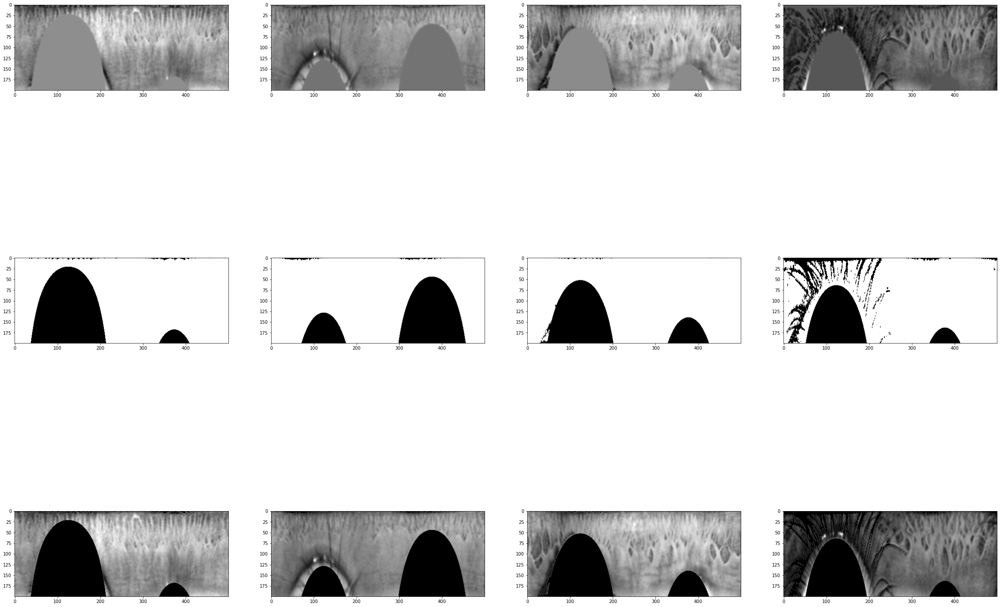

In [46]:
n=4
iris_segmented_db = np.array([a*b for a,b in zip(enhanced_iris, mask_iris)])
plotter.plot_image_sequence(enhanced_iris.tolist()[:n] + mask_iris.tolist()[:n] + iris_segmented_db.tolist()[:n], 3*n, n,  cmap='gray')

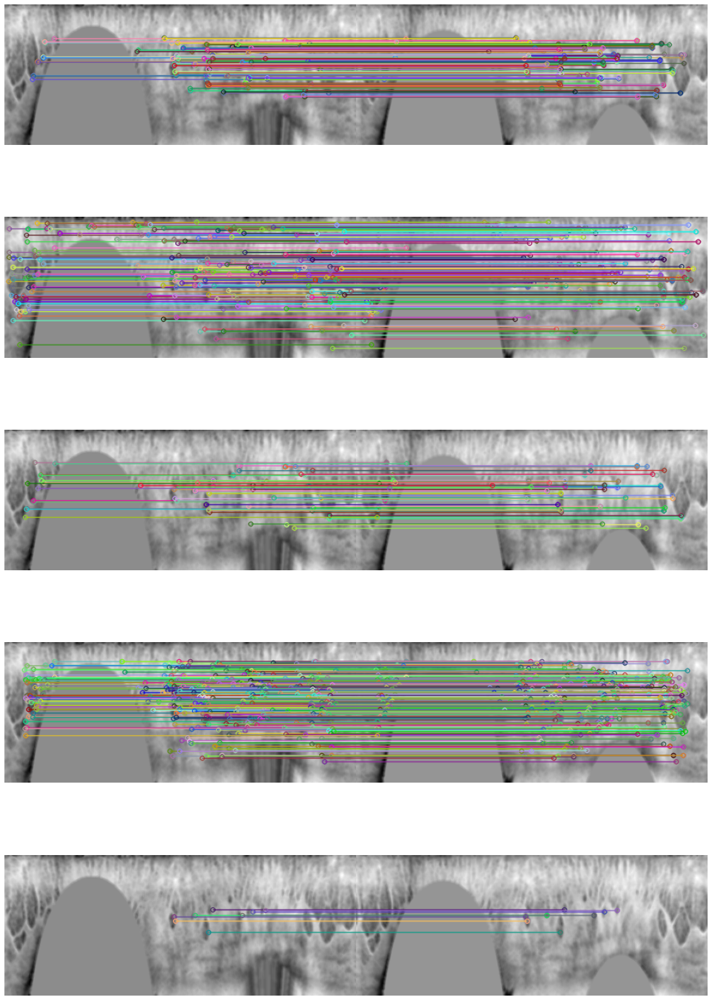

In [47]:
testNr1_iris, testNr2_iris = 35, 24
kp1_orb_iris = image_processor.detect_keypoints(enhanced_iris[testNr2_iris], mask_iris[testNr2_iris], detector_orb)
kp2_orb_iris = image_processor.detect_keypoints(enhanced_iris[testNr2_iris], mask_iris[testNr2_iris], detector_orb)
kp1_sift_iris = image_processor.detect_keypoints(enhanced_iris[testNr2_iris], mask_iris[testNr2_iris], detector_sift)
kp2_sift_iris = image_processor.detect_keypoints(enhanced_iris[testNr2_iris], mask_iris[testNr2_iris], detector_sift)
kp1_harris_iris = image_processor.detect_keypoints(enhanced_iris[testNr2_iris], mask_iris[testNr2_iris], detector_harris)
kp2_harris_iris = image_processor.detect_keypoints(enhanced_iris[testNr2_iris], mask_iris[testNr2_iris], detector_harris)
kp1_fast_iris = image_processor.detect_keypoints(enhanced_iris[testNr2_iris], mask_iris[testNr2_iris], detector_fast)
kp2_fast_iris = image_processor.detect_keypoints(enhanced_iris[testNr2_iris], mask_iris[testNr2_iris], detector_fast)
kp1_star_iris = image_processor.detect_keypoints(enhanced_iris[testNr2_iris], mask_iris[testNr2_iris], detector_star)
kp2_star_iris = image_processor.detect_keypoints(enhanced_iris[testNr2_iris], mask_iris[testNr2_iris], detector_star)

kp1_orb_iris, local_des1_orb_iris = image_processor.compute_local_descriptor(enhanced_iris[testNr2_iris], kp1_orb_iris, detector_orb)
kp2_orb_iris, local_des2_orb_iris = image_processor.compute_local_descriptor(enhanced_iris[testNr2_iris], kp2_orb_iris, detector_orb)
kp1_sift_iris, local_des1_sift_iris = image_processor.compute_local_descriptor(enhanced_iris[testNr2_iris], kp1_sift_iris, detector_sift)
kp2_sift_iris, local_des2_sift_iris = image_processor.compute_local_descriptor(enhanced_iris[testNr2_iris], kp2_sift_iris, detector_sift)
kp1_harris_iris, local_des1_harris_iris = image_processor.compute_local_descriptor(enhanced_iris[testNr2_iris], kp1_harris_iris, brief_detector)
kp2_harris_iris, local_des2_harris_iris = image_processor.compute_local_descriptor(enhanced_iris[testNr2_iris], kp2_harris_iris, brief_detector)
kp1_fast_iris, local_des1_fast_iris = image_processor.compute_local_descriptor(enhanced_iris[testNr2_iris], kp1_fast_iris, brief_detector)
kp2_fast_iris, local_des2_fast_iris = image_processor.compute_local_descriptor(enhanced_iris[testNr2_iris], kp2_fast_iris, brief_detector)
kp1_star_iris, local_des1_star_iris = image_processor.compute_local_descriptor(enhanced_iris[testNr2_iris], kp1_star_iris, brief_detector)
kp2_star_iris, local_des2_star_iris = image_processor.compute_local_descriptor(enhanced_iris[testNr2_iris], kp2_star_iris, brief_detector)

local_k1_k2_matches__orb_iris = image_processor.brute_force_matcher(local_des1_orb_iris, local_des2_orb_iris, cv2.NORM_HAMMING)
local_k1_k2_matches__sift_iris = image_processor.brute_force_matcher(local_des1_sift_iris, local_des2_sift_iris, cv2.NORM_L2)
local_k1_k2_matches__harris_iris = image_processor.brute_force_matcher(local_des1_harris_iris, local_des2_harris_iris, cv2.NORM_L2)
local_k1_k2_matches__fast_iris = image_processor.brute_force_matcher(local_des1_fast_iris, local_des2_fast_iris, cv2.NORM_L2)
local_k1_k2_matches__star_iris = image_processor.brute_force_matcher(local_des1_star_iris, local_des2_star_iris, cv2.NORM_L2)

fig, axs = plt.subplots(5, 1, figsize=(20, 30))
plotter.draw_matches(kp1_orb_iris, kp2_orb_iris, local_k1_k2_matches__orb_iris, enhanced_iris, testNr1_iris, testNr2_iris, axs[0])
plotter.draw_matches(kp1_sift_iris, kp2_sift_iris, local_k1_k2_matches__sift_iris, enhanced_iris, testNr1_iris, testNr2_iris, axs[1])
plotter.draw_matches(kp1_harris_iris, kp2_harris_iris, local_k1_k2_matches__harris_iris, enhanced_iris, testNr1_iris, testNr2_iris, axs[2])
plotter.draw_matches(kp1_fast_iris, kp2_fast_iris, local_k1_k2_matches__fast_iris, enhanced_iris, testNr1_iris, testNr2_iris, axs[3])
plotter.draw_matches(kp1_star_iris, kp2_star_iris, local_k1_k2_matches__star_iris, enhanced_iris, testNr1_iris, testNr2_iris, axs[4])

<div class="alert alert-block alert-success">
<b>Q7: </b> Construct a similarity table with the iris images. Use local OR global matches in order to get scores. Use the scores you get to determine the perpetrator.
</div>

In [48]:
perp_iris_en, perp_iris_mask = image_processor.enhance_and_segment_irises([iris_perpetrator])
perp_iris_en = perp_iris_en[0]
perp_iris_mask = perp_iris_mask[0]

100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


In [49]:
sim_tb4 = matrix_constructor.construct_similarity_table(np.stack((perp_iris_en, perp_iris_mask), -1), np.stack((iris_segmented_db, mask_iris), -1), iris_labels, matrix_constructor.local_similarity, detector=detector_fast, metric='mean', top_n=30)
sim_tb4.sort_values(by='score', ascending=False)

[28.0, 29.0, 30.0, 31.0, 31.0, 31.0, 31.0, 32.0, 32.0, 33.0, 34.0, 35.0, 35.0, 35.0, 35.0, 36.0, 36.0, 37.0, 37.0, 38.0, 38.0, 39.0, 40.0, 40.0, 40.0, 40.0, 40.0, 41.0, 42.0, 42.0, 42.0, 43.0, 43.0, 43.0, 44.0, 44.0, 44.0, 44.0, 44.0, 44.0, 44.0, 45.0, 45.0, 45.0, 45.0, 46.0, 46.0, 46.0, 47.0, 48.0, 49.0, 49.0, 50.0, 50.0, 51.0, 51.0, 51.0, 51.0, 52.0, 52.0, 52.0, 52.0, 53.0, 54.0, 55.0, 56.0, 56.0, 56.0, 57.0, 58.0, 58.0, 60.0, 60.0, 61.0, 62.0, 62.0, 62.0, 63.0, 65.0, 65.0, 66.0, 72.0]
[36.0, 40.0, 43.0, 46.0, 46.0, 46.0, 47.0, 48.0, 48.0, 49.0, 50.0, 50.0, 51.0, 52.0, 52.0, 53.0, 53.0, 55.0, 56.0, 56.0, 56.0, 56.0, 56.0, 57.0, 57.0, 58.0, 58.0, 59.0, 60.0, 60.0, 61.0, 61.0, 62.0, 63.0, 63.0, 63.0, 63.0, 64.0, 65.0, 70.0, 75.0, 75.0]
[10.0, 13.0, 14.0, 14.0, 15.0, 16.0, 16.0, 17.0, 17.0, 17.0, 17.0, 18.0, 18.0, 19.0, 19.0, 19.0, 19.0, 19.0, 19.0, 20.0, 20.0, 20.0, 20.0, 20.0, 20.0, 21.0, 21.0, 21.0, 22.0, 22.0, 22.0, 22.0, 22.0, 22.0, 23.0, 23.0, 23.0, 23.0, 23.0, 23.0, 23.0, 24.0, 2

,id,score
35,036,0.163043
62,063,0.158730
92,093,0.138249
90,091,0.138249
55,056,0.107527
...,...,...
75,076,0.017503
34,035,0.017431
99,100,0.017222
31,032,0.016763


1 036 0.16304
2 063 0.15873
3 093 0.13825
4 091 0.13825
5 056 0.10753
6 083 0.10169
7 025 0.08621
8 010 0.07426
9 003 0.05525
10 088 0.05525
Knee at: 8	 Treshold:  0.26755099000602356


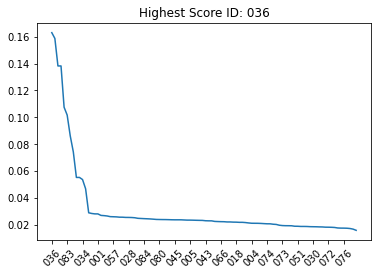

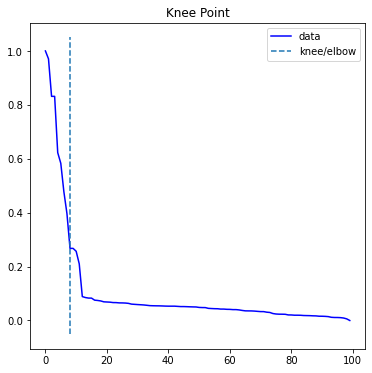

In [50]:
sim_tb4, ids4, scores4, kneedle4 = plotter.plot_highest_score_and_knee(sim_tb4, similarity_metric='hybrid')

How is this possible? Iris scans don't provide a clear suspect either. 

  0%|          | 0/7 [00:00<?, ?it/s]

Plotting images...


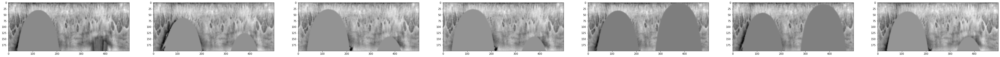

In [51]:
plotter.plot_images_given_knee(ids4, kneedle4, iris_labels, enhanced_iris)

They are all the same once again. There is no doubt about it now, there is an insider messing with the data! Lucky for us, but unlucky for them, they slipped up. We can now construct a multimodal biometric system in order to catch the perpetrator.

In [52]:
thresholds_iris = {
    'euclidean': 0.01, 'sqeuclidean': 0.00002, 'cityblock': 0.01, 'l1': 0.01, 'l2': 0.01,
    'manhattan': 0.01, 'braycurtis': 4, 'canberra': 3, 'chebyshev': 0.01
}

1 036 112.00000
2 063 111.00000
3 025 84.00000
4 010 84.00000
5 093 82.00000
6 088 82.00000
7 091 82.00000
8 003 82.00000
9 034 57.00000
10 056 52.00000
Knee at: 4	 Treshold:  0.7321428571428571


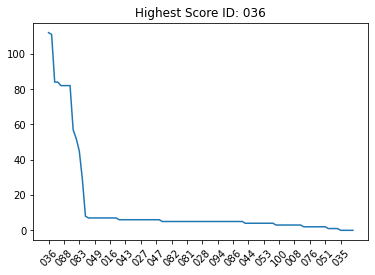

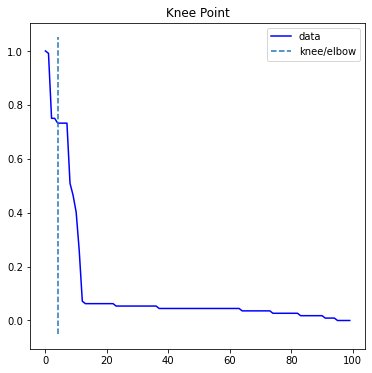

In [53]:
sim_tb5 = matrix_constructor.construct_similarity_table(np.stack((perp_iris_en, perp_iris_mask), -1), np.stack((iris_segmented_db, mask_iris), -1), iris_labels, matrix_constructor.global_similarity, dist_fct_n='braycurtis', thresholds=thresholds_iris, detector=detector_sift)
sim_tb5, ids5, scores5, kneedle5 = plotter.plot_highest_score_and_knee(sim_tb5, similarity_metric='hybrid')

  0%|          | 0/4 [00:00<?, ?it/s]

Plotting images...


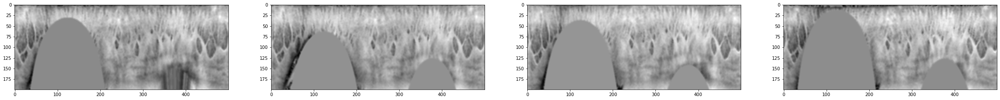

In [54]:
plotter.plot_images_given_knee(ids5, kneedle5, iris_labels, enhanced_iris)

dist 305.8185729980469
dist 306.9478759765625
dist 321.2164306640625
dist 340.1676025390625
dist 359.9375
lower than  0
dist 291.7464599609375
dist 316.9668884277344
dist 323.9783935546875
dist 325.0738525390625
dist 337.7780456542969
lower than  0
dist 87.34414672851562
dist 94.18598937988281
dist 99.28746032714844
dist 101.01484680175781
dist 107.44300842285156
dist 107.50814056396484
dist 109.9590835571289
dist 119.24344635009766
dist 126.63333129882812
dist 127.18883514404297
dist 134.4209747314453
dist 137.10215759277344
dist 143.30735778808594
dist 145.392578125
dist 145.40289306640625
dist 145.6674346923828
dist 146.1027069091797
dist 148.95301818847656
dist 152.31874084472656
dist 153.22206115722656
dist 156.66844177246094
dist 159.0691680908203
dist 160.37144470214844
dist 161.90737915039062
dist 162.76055908203125
dist 164.55393981933594
dist 166.4722137451172
dist 169.78221130371094
dist 170.28504943847656
dist 173.91090393066406
dist 181.8818359375
dist 182.1180877685547
di

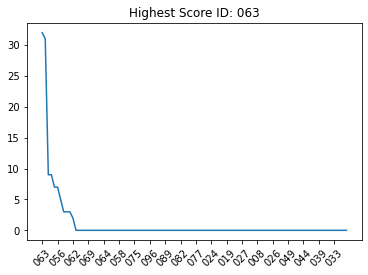

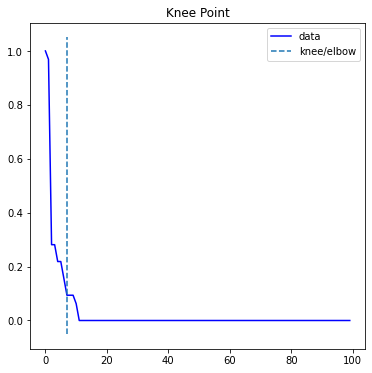

In [55]:
sim_tb6 = matrix_constructor.construct_similarity_table(np.stack((perp_iris_en, perp_iris_mask), -1), np.stack((iris_segmented_db, mask_iris), -1), iris_labels, matrix_constructor.hybrid_similarity, dist_fct_n='braycurtis', thresholds=thresholds_iris, detector=detector_sift)
sim_tb6, ids6, scores6, kneedle6 = plotter.plot_highest_score_and_knee(sim_tb6, similarity_metric='hybrid')

  0%|          | 0/7 [00:00<?, ?it/s]

Plotting images...


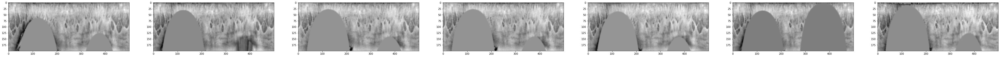

In [56]:
plotter.plot_images_given_knee(ids6, kneedle6, iris_labels, enhanced_iris)

## IV Multimodal System

<div class="alert alert-block alert-success">
<b>Q8: </b> Fuse your iris and fingerprint biometric system on the score level to solve the murder case! Do you feel confident in your prediction? How do you fuse the scores? Why?
</div>

In [57]:
sim_finger = matrix_constructor.construct_similarity_table(np.stack((perp_img_en, perp_img_mask), -1), np.stack((images_segmented_db, masks_db), -1), labels_db, matrix_constructor.hybrid_similarity, dist_fct_n='sqeuclidean', detector=detector_fast, thresholds=thresholds_fingerprint)
sim_finger.sort_values(by='score', ascending=False)

dist 62.0
dist 66.0
dist 67.0
dist 68.0
dist 69.0
dist 70.0
dist 71.0
dist 75.0
dist 76.0
dist 77.0
dist 78.0
dist 78.0
dist 80.0
dist 84.0
dist 85.0
highest score  0.00021986388419972043 1
lowest score  0.00018497669838339332 0
lower than  4
dist 47.0
dist 47.0
dist 55.0
dist 55.0
dist 55.0
dist 60.0
dist 60.0
dist 61.0
dist 61.0
dist 61.0
dist 62.0
dist 69.0
dist 71.0
dist 80.0
dist 80.0
dist 81.0
lower than  0
dist 34.0
dist 53.0
dist 55.0
dist 56.0
dist 57.0
dist 58.0
dist 59.0
dist 59.0
dist 62.0
dist 63.0
dist 64.0
dist 64.0
dist 65.0
dist 68.0
dist 70.0
highest score  0.0001157998242834369 3
lowest score  6.223436663772074e-05 4
lower than  15
dist 67.0
dist 70.0
dist 72.0
dist 75.0
dist 75.0
dist 76.0
dist 79.0
dist 79.0
dist 81.0
dist 83.0
dist 84.0
dist 85.0
dist 86.0
dist 91.0
highest score  4.136846254541203e-05 9
lowest score  1.986066497900484e-05 12
lower than  14
dist 48.0
dist 49.0
dist 49.0
dist 56.0
dist 64.0
dist 69.0
dist 72.0
dist 74.0
dist 75.0
dist 76.0
dist 76.

,id,score
55,056,373
48,049,369
47,048,311
75,076,308
17,018,299
...,...,...
84,085,0
58,059,0
71,072,0
80,081,0


In [58]:
sim_iris = matrix_constructor.construct_similarity_table(np.stack((perp_iris_en, perp_iris_mask), -1), np.stack((iris_segmented_db, mask_iris), -1), iris_labels, matrix_constructor.hybrid_similarity, dist_fct_n='braycurtis', thresholds=thresholds_iris, detector=detector_sift)
sim_iris.sort_values(by='score', ascending=False)

dist 305.8185729980469
dist 306.9478759765625
dist 321.2164306640625
dist 340.1676025390625
dist 359.9375
lower than  0
dist 291.7464599609375
dist 316.9668884277344
dist 323.9783935546875
dist 325.0738525390625
dist 337.7780456542969
lower than  0
dist 87.34414672851562
dist 94.18598937988281
dist 99.28746032714844
dist 101.01484680175781
dist 107.44300842285156
dist 107.50814056396484
dist 109.9590835571289
dist 119.24344635009766
dist 126.63333129882812
dist 127.18883514404297
dist 134.4209747314453
dist 137.10215759277344
dist 143.30735778808594
dist 145.392578125
dist 145.40289306640625
dist 145.6674346923828
dist 146.1027069091797
dist 148.95301818847656
dist 152.31874084472656
dist 153.22206115722656
dist 156.66844177246094
dist 159.0691680908203
dist 160.37144470214844
dist 161.90737915039062
dist 162.76055908203125
dist 164.55393981933594
dist 166.4722137451172
dist 169.78221130371094
dist 170.28504943847656
dist 173.91090393066406
dist 181.8818359375
dist 182.1180877685547
di

,id,score
62,063,32
35,036,31
90,091,9
92,093,9
24,025,7
...,...,...
32,033,0
31,032,0
30,031,0
29,030,0


In [59]:
sim_finger['norm_score'] = (sim_finger['score']-sim_finger['score'].min())/(sim_finger['score'].max()-sim_finger['score'].min())
# sim_finger.sort_values(by='score', ascending=False)
sim_finger

,id,score,norm_score
0,001,4,0.010724
1,002,0,0.000000
2,003,15,0.040214
3,004,14,0.037534
4,005,15,0.040214
...,...,...,...
95,096,8,0.021448
96,097,1,0.002681
97,098,3,0.008043
98,099,11,0.029491


In [60]:
sim_iris['norm_score'] = (sim_iris['score']-sim_iris['score'].min())/(sim_iris['score'].max()-sim_iris['score'].min())
# sim_iris.sort_values(by='score', ascending=False)
sim_iris

,id,score,norm_score
0,001,0,0.00000
1,002,0,0.00000
2,003,3,0.09375
3,004,0,0.00000
4,005,0,0.00000
...,...,...,...
95,096,0,0.00000
96,097,0,0.00000
97,098,0,0.00000
98,099,0,0.00000


In [61]:
sim_fuse = pd.DataFrame(sim_finger['id'])
sim_fuse['score'] = 0.5 * sim_finger['norm_score'] + 0.5 * sim_iris['norm_score']
sim_fuse

,id,score
0,001,0.005362
1,002,0.000000
2,003,0.066982
3,004,0.018767
4,005,0.020107
...,...,...
95,096,0.010724
96,097,0.001340
97,098,0.004021
98,099,0.014745


1 056 0.60938
2 063 0.51743
3 049 0.49464
4 036 0.49108
5 048 0.41689
6 076 0.41287
7 018 0.40080
8 022 0.35255
9 093 0.15537
10 091 0.15403
Knee at: 16	 Treshold:  0.04619509177149928


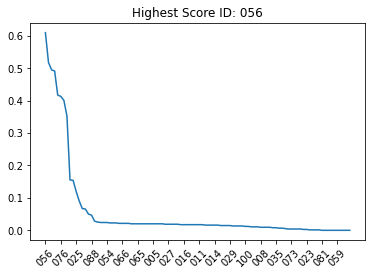

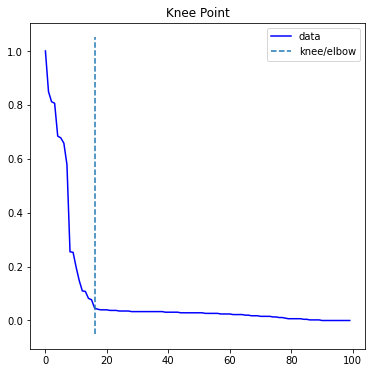

In [62]:
sim_fuse, ids_fuse, scores_fuse, kneedle_fuse = plotter.plot_highest_score_and_knee(sim_fuse, similarity_metric='hybrid')

## V. Assignment Instructions
[FING or IRIS] Create a machine learning based identification/authentication system and evaluate it (6pt)
        - e.g. based on deep learning
        - training is required, transfer learning is allowed

In [63]:
from datetime import datetime
import os
import glob
import shutil
import sys
from src.neural_network.data_preprocessing import DataPreProcessor
from src.neural_network.model_class import TransferModels, IrisModel
import tensorflow as tf

## Preprocessing the data

### Preparing the dataset folder
Each iris is unique for every individual and for left and right side. We are going to make a folder containing each different iris (left or right) as different class (left iris will end on 1 and right iris will end on 2)

In [64]:
input_folder = "data/dataset/"
output_folder = "data/datasetv2/"
imagePaths = sorted(os.listdir(input_folder))
if not os.path.exists(output_folder):
    os.mkdir(output_folder)
    for id in imagePaths:
        for side, n in zip(['L', 'R'], [1, 2]):
            src_dir = input_folder + id + '/' + side
            dst_dir = output_folder + id + str(n)
            os.mkdir(dst_dir)
            for jpgfile in glob.iglob(os.path.join(src_dir, "*.jpg")):
                shutil.copy(jpgfile, dst_dir)

folders = list(os.walk(output_folder))[1:]

# remove empty folders and folders with not enough data
for folder in folders:
    # folder example: ('FOLDER/3', [], ['file'])
    if len(folder[2]) < 4:
        for imagePaths in os.listdir(folder[0]):
            os.remove(folder[0] + '/' + imagePaths)
        os.rmdir(folder[0])

In [65]:
### Split the data into train, val and test folders

In [66]:
import splitfolders

# Split with a ratio.
# To only split into training and validation set, set a tuple to `ratio`, i.e, `(.8, .2)`.
out_folder = "data/datasetv2_prepped/"
if not os.path.exists(out_folder):
    splitfolders.fixed(output_folder, output=out_folder,
        seed=1337, fixed=(2, 1), group_prefix=None, move=False) # default values

### Preprocess the data

#### Load the iris images as numpy arrays

In [67]:
train_images, train_labels, train_labels_ids, train_ids = image_processor.read_iris_casia_db(out_folder +'\\train\\')
val_images, val_labels, val_labels_ids, val_ids = image_processor.read_iris_casia_db(out_folder + '\\val\\')
test_images, test_labels, test_labels_ids, test_ids = image_processor.read_iris_casia_db(out_folder + '\\test\\')
print(len(train_images), len(val_images), len(test_images))


1509 698 349


### Image enhancement

In [68]:
try:
    with open("data/iris_mask_dataset_v2_db_train.pkl", "rb") as f:
        enhanced_iris_train, mask_iris_train = pickle.load(f)
except:
    enhanced_iris_train, mask_iris_train = image_processor.enhance_and_segment_irises(train_images, radial_res=200, angular_res=500)
    with open("data/iris_mask_dataset_v2_db_train.pkl", "wb") as f:
        pickle.dump([enhanced_iris_train, mask_iris_train], f)

In [69]:
try:
    with open("data/iris_mask_dataset_v2_db_val.pkl", "rb") as f:
        enhanced_iris_val, mask_iris_val = pickle.load(f)
except:
    enhanced_iris_val, mask_iris_val = image_processor.enhance_and_segment_irises(val_images, radial_res=200, angular_res=500)
    with open("data/iris_mask_dataset_v2_db_val.pkl", "wb") as f:
        pickle.dump([enhanced_iris_val, mask_iris_val], f)

In [70]:
try:
    with open("data/iris_mask_dataset_v2_db_test.pkl", "rb") as f:
        enhanced_iris_test, mask_iris_test = pickle.load(f)
except:
    enhanced_iris_test, mask_iris_test = image_processor.enhance_and_segment_irises(test_images, radial_res=200, angular_res=500)
    with open("data/iris_mask_dataset_v2_db_test.pkl", "wb") as f:
        pickle.dump([enhanced_iris_test, mask_iris_test], f)

  0%|          | 0/3 [00:00<?, ?it/s]

Plotting images...


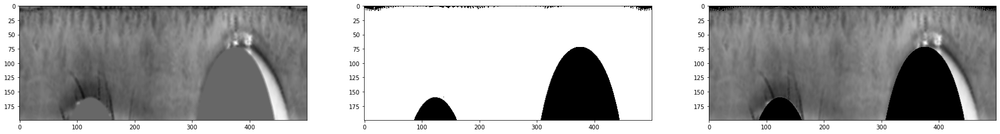

In [71]:
n=2
train_segmented_db = np.array([a*b for a,b in zip(enhanced_iris_train, mask_iris_train)])
val_segmented_db = np.array([a*b for a,b in zip(enhanced_iris_val, mask_iris_val)])
test_segmented_db = np.array([a*b for a,b in zip(enhanced_iris_test, mask_iris_test)])

plotter.plot_image_sequence(enhanced_iris_train.tolist()[1:n] + mask_iris_train.tolist()[1:n] + train_segmented_db.tolist()[1:n], 3*(n-1), 3,  cmap='gray')

In [82]:
train_set = np.array([cv2.cvtColor(gray,cv2.COLOR_GRAY2RGB) for gray in train_segmented_db])
val_set = np.array([cv2.cvtColor(gray,cv2.COLOR_GRAY2RGB) for gray in val_segmented_db])
test_set = np.array([cv2.cvtColor(gray,cv2.COLOR_GRAY2RGB) for gray in test_segmented_db])

In [86]:
## Create smaller dataset for computational power limitation (keep 50 classes
train_y_small = train_labels_ids[:258]
train_x_small = train_set[:258]
val_y_small = val_labels_ids[:102]
val_x_small = val_set[:102]
test_y_small = test_labels_ids[:51]
test_x_small = test_set[:51]

In [84]:
train_x_small[0].shape

(200, 500, 3)

In [87]:
data_processor = DataPreProcessor(images_train_x=train_x_small, images_train_y=train_y_small,
                                  images_val_x=val_x_small, images_val_y=val_y_small,
                                  images_test_x=test_x_small, images_test_y=test_y_small,
                                  image_shape=train_x_small[0].shape)

### Sample images

  0%|          | 0/7 [00:00<?, ?it/s]

Plotting images...


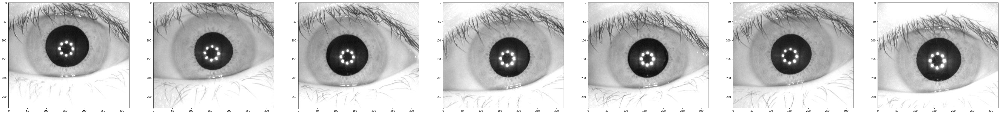


Let's have a look at the dataset... It contains 411 images and the size of the images is 200×500. It has 51 classes. Let's visualise the first 7 images:


In [88]:
n = 7
plotter.plot_image_sequence(train_images, n)

Markdown("""
Let's have a look at the dataset... It contains {} images and the size of the images is {}×{}. It has {} classes. Let's visualise the first 7 images:
""".format(data_processor.get_total_images_count, data_processor.image_shape[0], data_processor.image_shape[1], data_processor.get_iris_count))

### Retrieve train, val and test set

In [89]:
training_set = data_processor.get_train_set
val_set = data_processor.get_val_set
test_set = data_processor.get_test_set
data_processor.get_iris_count

51

## Build Model

In [102]:
model = IrisModel(optimiser='adam', input_size=train_set[0].shape, n_classes=data_processor.get_iris_count)
model.compute_model(transfer_model=TransferModels.inception_resnet_V2)

ic| len(tf_model.layers): 780


Model: "inception_resnet_v2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 200, 500, 3) 0                                            
__________________________________________________________________________________________________
conv2d_203 (Conv2D)             (None, 99, 249, 32)  864         input_2[0][0]                    
__________________________________________________________________________________________________
batch_normalization_203 (BatchN (None, 99, 249, 32)  96          conv2d_203[0][0]                 
__________________________________________________________________________________________________
activation_203 (Activation)     (None, 99, 249, 32)  0           batch_normalization_203[0][0]    
________________________________________________________________________________

### train the model on the new data for a few epochs
We use the pretrained model on 'imagenet'

In [103]:
model.fit(training_set, val_set, model_choice='inception_resnet_V2', epochs=150)

Epoch 1/150
5/5 [==============================] - 18s 3s/step - loss: 4.5434 - accuracy: 0.0349 - val_loss: 4.5613 - val_accuracy: 0.0426

Epoch 00001: val_loss improved from inf to 4.56131, saving model to neural_network/model\inception_resnet_V2.01-0.04.hdf5
Epoch 2/150
5/5 [==============================] - 7s 2s/step - loss: 4.3263 - accuracy: 0.0426 - val_loss: 3.9309 - val_accuracy: 0.0853

Epoch 00002: val_loss improved from 4.56131 to 3.93093, saving model to neural_network/model\inception_resnet_V2.02-0.09.hdf5
Epoch 3/150
5/5 [==============================] - 8s 2s/step - loss: 4.1257 - accuracy: 0.0504 - val_loss: 3.7713 - val_accuracy: 0.1047

Epoch 00003: val_loss improved from 3.93093 to 3.77132, saving model to neural_network/model\inception_resnet_V2.03-0.10.hdf5
Epoch 4/150
5/5 [==============================] - 7s 2s/step - loss: 3.7756 - accuracy: 0.0620 - val_loss: 3.6039 - val_accuracy: 0.1047

Epoch 00004: val_loss improved from 3.77132 to 3.60393, saving model 

#### evaluate our model

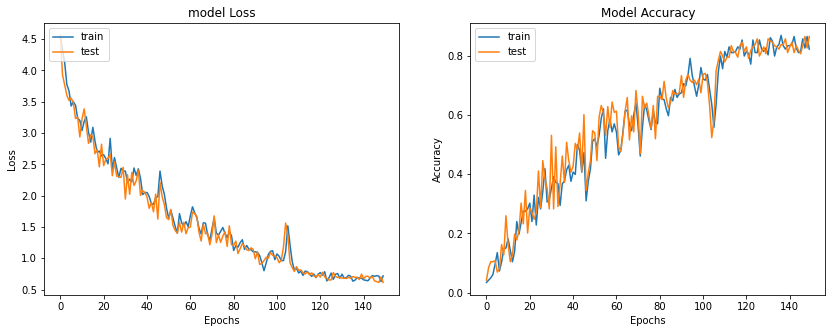

In [104]:
model.plot_accuracy_and_loss_plt()

### Fine Tuning
We first get our model and unfreeze some of the last layers of our model

In [105]:
model_tf = model.get_model
model_tf = model.activate_training_layers(model_tf, 700)
model.set_model(model_tf)
model.compile_model(opt=tf.keras.optimizers.Adam(1e-5)) ## slow learning

ic| len(tf_model.layers): 783


In [106]:
model.fit(training_set, val_set, model_choice='inception_resnet_V2', epochs=30)

Epoch 1/30
5/5 [==============================] - 18s 2s/step - loss: 0.6778 - accuracy: 0.8411 - val_loss: 0.6197 - val_accuracy: 0.8605

Epoch 00001: val_loss improved from inf to 0.61965, saving model to neural_network/model\inception_resnet_V2.01-0.86.hdf5
Epoch 2/30
5/5 [==============================] - 8s 2s/step - loss: 0.6157 - accuracy: 0.8372 - val_loss: 0.6066 - val_accuracy: 0.8682

Epoch 00002: val_loss improved from 0.61965 to 0.60659, saving model to neural_network/model\inception_resnet_V2.02-0.87.hdf5
Epoch 3/30
5/5 [==============================] - 8s 2s/step - loss: 0.6509 - accuracy: 0.8372 - val_loss: 0.7701 - val_accuracy: 0.7946

Epoch 00003: val_loss did not improve from 0.60659
Epoch 4/30
5/5 [==============================] - 7s 2s/step - loss: 0.6248 - accuracy: 0.8643 - val_loss: 0.6713 - val_accuracy: 0.8256

Epoch 00004: val_loss did not improve from 0.60659
Epoch 5/30
5/5 [==============================] - 7s 2s/step - loss: 0.7209 - accuracy: 0.8062 - 

#### evaluate our model after fine tuning

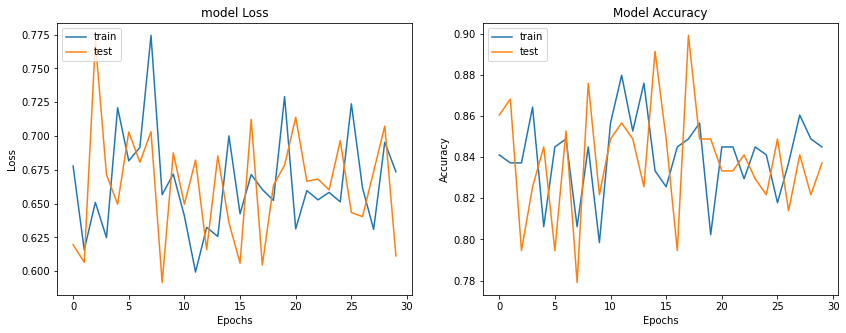

In [107]:
model.plot_accuracy_and_loss_plt()

In [108]:
predict = model_tf.predict(x=test_x_small)

In [109]:
from sklearn.metrics import roc_auc_score, roc_curve
auc_score = roc_auc_score(y_true=test_y_small, y_score=predict, multi_class='ovo')
auc_score

0.4970588235294118

## VI. Assignment Instructions
Both a report and the implementation in this notebook have to be submitted to toledo. <u>The notebook functions as supplementary material only!</u> The report should be self contained. Feel free to add figures, code and mathematics in the report if you feel comfortable. Try to be concice and to the point and try keep your report below 10 pages. 

1. Follow the instructions in the notebook and discuss results/impact in your report.
2. <b>Choose a number of tasks equivalent to <u>at least 6pts</u> from the list below (pts are not related to the grades): </b>
    1. [FING and IRIS] OpenCV provides different KeyPoint detectors and descriptors (ORB, SIFT, SURF, BRIEF, ...). Briefly test, visually, which of these seem to extract relatively reliable interesting points from the fingerprints or iris dataset (you can skip the ones that require a lisence). Use <u> at least 3 detectors</u>. (1pt)
    2. [IRIS] Play around with the gabor filter bank, what is the effect of the parameters? Can you setup a databank that results in better features? (1pt)
    3. [FING] Can you find a better way to aggregate the gabor feature maps? Analyse and report. (1pt) 
    4. [IRIS] Compare local hybrid and global features for the iris data (1pt).
    5. [FING] Try a neural network approach in order to get similarity scores directly from image data without feature extraction. (1pt)
    6. [FING] Attempt to improve the registration procedure. (1pt) 
    7. [FING or IRIS] Attempt to improve the segmentation, evaluate. (3pt) 
    8. [FING or IRIS] Attempt to improve the feature extraction using a completely different technique. Evaluate your results. (3pt)
    9. [MULTI] Fuse your modalities on the feature level instead of the score level (3pt)
    10. [ . ] Create a biometric identification or authentication system on a modality of choice and evaluate it (6pt)
        - e.g. on smartphone usage patterns 
        - Excludes; Fingerprints, irises and faces
    11. [FING or IRIS] Create a machine learning based identification/authentication system and evaluate it (6pt)
        - e.g. based on deep learning 
        - training is required, transfer learning is allowed 
3. All results should be discussed in detail in your report. 


<em>Note: Indicate clearly which tasks you end up choosing and where we can find the implementations and/or results. </em> <br>
<em>Note 2: Usually there are multiple valid solutions, you should always defend your approach and verbally compare it to the other approaches (possible advantages/disadvantages) in your report! If you do not provide proper reasoning we can not give you the grades you deserve! </em>

Good luck, have fun!